# Räumliche Exploration

In diesem Notebook werden die räumlichen Muster der CitiBike-Nutzung (räumliche Exposure) und der NYPD-Verkehrsunfälle untersucht. 
Ziel ist es, die räumliche Lage der Nutzung und der Schadenereignisse darzustellen und zu vergleichen.

Es wird analysiert:

- in welchen Bereichen sich die Fahrradnutzung konzentriert,
- wo Unfälle auftreten, sowohl insgesamt als auch mit Beteiligung von Cyclists,
- in welchen Bereichen Nutzung und Unfälle übereinstimmen oder voneinander abweichen,
- welche räumlichen Auffälligkeiten Hinweise für spätere Hypothesen liefern können.

Zur Untersuchung werden die Punktdaten beider Quellen in ein gemeinsames räumliches Raster überführt. 
Innerhalb dieses Rasters werden aggregiert:

- räumliche Exposure (Start- und Endpunkte der Fahrten),
- Segmentierungen der Nutzung (z. B. Member/Casual, Classic/E-Bike),
- Unfallzahlen (gesamt und cyclist-involved).

Auf diese Weise entsteht ein strukturierter Überblick über die räumliche Verteilung der Nutzung und der Unfälle. 
Die Ergebnisse bilden eine Grundlage für die anschließende Ableitung von Hypothesen.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import contextily as ctx
from pyproj import Transformer
import os

import sys
sys.path.append("../..")

from utils.paths import DATA_RAW_PROCESSED
from utils.paths import FIGURES_DIR
from utils.paths import DATA_SPATIAL

# Unterordner für dieses Notebook
FIG_SUBDIR = "02B_spatial_exploration"
figures_path = os.path.join(FIGURES_DIR, FIG_SUBDIR)

# Ordner anlegen, falls nicht vorhanden
os.makedirs(figures_path, exist_ok=True)

## 1. Setup und Laden der Daten

In diesem Abschnitt werden die bereinigten Datensätze (`citibike_clean.parquet` und `nypd_clean.parquet`) geladen und grundlegende Größen überprüft.
Außerdem wird eine erste visuelle Kontrolle der Koordinaten durchgeführt, um Fehler zu erkennen.

In [2]:
# Daten laden
path_cb = os.path.join(DATA_RAW_PROCESSED, 'citibike_clean.parquet')
path_nypd = os.path.join(DATA_RAW_PROCESSED, 'nypd_clean.parquet')

df_cb = pd.read_parquet(path_cb)
df_nypd = pd.read_parquet(path_nypd)

print("CitiBike – Anzahl Zeilen und Spalten:", df_cb.shape)
print("NYPD – Anzahl Zeilen und Spalten:", df_nypd.shape)

print("CitiBike – Übersicht Koordinaten:")
print(df_cb[["start_lat", "start_lng"]].describe())

print("\nNYPD – Übersicht Koordinaten:")
print(df_nypd[["LATITUDE", "LONGITUDE"]].describe())

CitiBike – Anzahl Zeilen und Spalten: (35000377, 10)
NYPD – Anzahl Zeilen und Spalten: (89013, 31)
CitiBike – Übersicht Koordinaten:
          start_lat     start_lng
count  3.500038e+07  3.500038e+07
mean   4.073980e+01 -7.397277e+01
std    4.060470e-02  2.781732e-02
min    4.063338e+01 -7.408670e+01
25%    4.071485e+01 -7.399257e+01
50%    4.073902e+01 -7.398014e+01
75%    4.076313e+01 -7.395608e+01
max    4.088630e+01 -7.384978e+01

NYPD – Übersicht Koordinaten:
           LATITUDE     LONGITUDE
count  89013.000000  89013.000000
mean      40.722087    -73.919738
std        0.080781      0.085197
min       40.499996    -74.251860
25%       40.665596    -73.968895
50%       40.713963    -73.924050
75%       40.772587    -73.870390
max       40.912827    -73.700610


### 1.1 Visuelle Prüfung der Daten

Zur Überprüfung der Plausibilität werden zufällig ausgewählte CitiBike- und NYPD-Punkte geplottet.
Es wird kontrolliert, ob sich alle Punkte innerhalb des erwarteten NYC-Bereichs befinden.

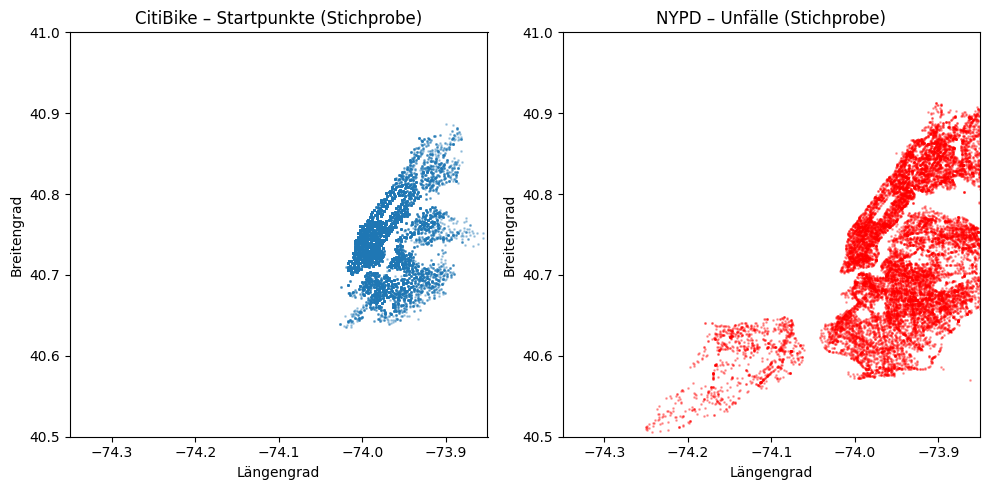

In [5]:
# Einheitliche Achsengrenzen für NYC (Manhattan und angrenzende Bereiche)
x_min, x_max = -74.35, -73.85
y_min, y_max = 40.50, 41.00

# Stichproben ziehen
sample_cb = df_cb.sample(20_000, random_state=42)
sample_nypd = df_nypd.sample(20_000, random_state=42)

# Side-by-side Figuren
fig, axes = plt.subplots(1, 2, figsize=(10, 5))

# CitiBike
axes[0].scatter(sample_cb["start_lng"], sample_cb["start_lat"], s=1, alpha=0.3)
axes[0].set_xlim(x_min, x_max)
axes[0].set_ylim(y_min, y_max)
axes[0].set_xlabel("Längengrad")
axes[0].set_ylabel("Breitengrad")
axes[0].set_title("CitiBike – Startpunkte (Stichprobe)")

# NYPD
axes[1].scatter(sample_nypd["LONGITUDE"], sample_nypd["LATITUDE"], s=1, alpha=0.3, color="red")
axes[1].set_xlim(x_min, x_max)
axes[1].set_ylim(y_min, y_max)
axes[1].set_xlabel("Längengrad")
axes[1].set_ylabel("Breitengrad")
axes[1].set_title("NYPD – Unfälle (Stichprobe)")

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "sample_start_vs_crashes_side_by_side.png"), dpi=300)
plt.show()

## 2. Erzeugung eines räumlichen Rasters und Zuordnung der Daten

Für die Analyse der räumlichen Muster wird ein vollständiges Raster über dem Gebiet erzeugt, in dem CitiBike tatsächlich genutzt wird. 
Die CitiBike-Daten definieren damit den relevanten räumlichen Exposure-Raum. 
NYPD-Daten decken ein wesentlich größeres Gebiet ab (z. B. Highways, Staten Island oder Gebiete ohne Fahrradinfrastruktur). 
Diese Unfälle bleiben zwar erhalten, werden später jedoch nicht für risikobezogene Auswertungen genutzt, da dort keine räumliche Exposure vorliegt.

### Gründe für eine CitiBike-basierte Bounding Box

- Start- und Endpunkte der Fahrten markieren den realen Raum, in dem Exposure entsteht.  
- Bereiche ohne CitiBike-Nutzung besitzen kein relevanten Exposure-Raum für Risiken.  
- Ein Raster, das auf CitiBike basiert, verhindert große Flächen ohne Daten und führt zu stabileren und interpretierbaren Darstellungen.

### Vorgehen

1. Bestimmung der Bounding Box anhand der CitiBike-Start- und Endpunkte (`start_lat`, `end_lat`, `start_lng`, `end_lng`).

2. Erzeugung eines vollständigen Rasters über diese Bounding Box:
   - Zellgröße: 0.003° × 0.003°, ca. 300 m
   - Für jede Zelle werden folgende Variablen angelegt:
     - `lat_bin`  – untere Kante der Rasterzelle im Breitengrad  
     - `lon_bin`  – untere Kante der Rasterzelle im Längengrad  
     - `lat_center` – Mittelpunkt der Zelle (Breitengrad)  
     - `lon_center` – Mittelpunkt der Zelle (Längengrad)  
     - `cell_idx` – eindeutiger numerischer Index pro Zelle

3. Zuordnung der CitiBike-Punkte zu Rasterzellen:
   - Zuordnung über die Variablen `start_cell_idx` und `end_cell_idx`

4. Zuordnung der NYPD-Unfälle zu denselben Rasterzellen:
   - Zuordnung über die Variable `crash_cell_idx`  
   - Unfälle außerhalb des Exposure-Raums erhalten den Wert `NaN`

5. Ergebnis:
   - Ein strukturiertes Raster (`df_cells`)
   - Zwei Datensätze (`df_cb`, `df_nypd`) mit konsistenter und vergleichbarer räumlicher Zuordnung

In [6]:
# Schrittweite für Rasterzellen
LAT_BIN_SIZE = 0.003
LON_BIN_SIZE = 0.003

# Bestimmung der Bounding Box auf Basis der CitiBike-Daten
lat_min = min(df_cb['start_lat'].min(), df_cb['end_lat'].min())
lat_max = max(df_cb['start_lat'].max(), df_cb['end_lat'].max())
lon_min = min(df_cb['start_lng'].min(), df_cb['end_lng'].min())
lon_max = max(df_cb['start_lng'].max(), df_cb['end_lng'].max())

# Bounding Box wird auf Rasterkanten gerundet
LAT_MIN = np.floor(lat_min / LAT_BIN_SIZE) * LAT_BIN_SIZE
LAT_MAX = np.ceil(lat_max / LAT_BIN_SIZE) * LAT_BIN_SIZE
LON_MIN = np.floor(lon_min / LON_BIN_SIZE) * LON_BIN_SIZE
LON_MAX = np.ceil(lon_max / LON_BIN_SIZE) * LON_BIN_SIZE

print("Bounding Box für räumliche Exposure festgelegt:")
print("  Breitengrad-Bereich:", LAT_MIN, "bis", LAT_MAX)
print("  Längengrad-Bereich:", LON_MIN, "bis", LON_MAX)

# Rasterzellen erzeugen
lat_bins = np.arange(LAT_MIN, LAT_MAX + LAT_BIN_SIZE, LAT_BIN_SIZE).round(6)
lon_bins = np.arange(LON_MIN, LON_MAX + LON_BIN_SIZE, LON_BIN_SIZE).round(6)

# Rasterkombination aus Breitengrad- und Längengrad-Bins erzeugen
# Es entsteht für jede Kombination (lat_bin, lon_bin) genau eine Rasterzelle
grid_lat, grid_lon = np.meshgrid(lat_bins, lon_bins, indexing='ij') # jede unique Kombi

df_cells = pd.DataFrame({
    'lat_bin': grid_lat.ravel(),
    'lon_bin': grid_lon.ravel()
})

# Mittelpunktkoordinaten der Rasterzellen berechnen
df_cells['lat_center'] = df_cells['lat_bin'] + LAT_BIN_SIZE/2
df_cells['lon_center'] = df_cells['lon_bin'] + LON_BIN_SIZE/2

# Eindeutiger Index pro Rasterzelle zur späteren Zuordnung
df_cells['cell_idx']   = np.arange(len(df_cells))

print("Raster erzeugt – Anzahl Zellen:", len(df_cells))

# Schlüsselberechnung für Lookup
def make_key(lat, lon):
    # Es wird ein eindeutiger numerischer Schlüssel pro Rasterzelle generiert
    lat_i = (lat * 1_000_000).astype("int64")
    lon_i = (lon * 1_000_000).astype("int64")
    return lat_i * 1_000_000_000 + lon_i

df_cells['key'] = make_key(df_cells['lat_bin'], df_cells['lon_bin'])
cell_lookup = dict(zip(df_cells['key'], df_cells['cell_idx']))

# Binning der CitiBike-Start- und Endpunkte
df_cb['start_lat_bin'] = (np.floor(df_cb['start_lat'] / LAT_BIN_SIZE) * LAT_BIN_SIZE).round(6)
df_cb['start_lon_bin'] = (np.floor(df_cb['start_lng'] / LON_BIN_SIZE) * LON_BIN_SIZE).round(6)
df_cb['end_lat_bin']   = (np.floor(df_cb['end_lat']   / LAT_BIN_SIZE) * LAT_BIN_SIZE).round(6)
df_cb['end_lon_bin']   = (np.floor(df_cb['end_lng']   / LON_BIN_SIZE) * LON_BIN_SIZE).round(6)

# Schlüssel für Start- und Endpunkte pro Fahrt
df_cb['start_key'] = make_key(df_cb['start_lat_bin'], df_cb['start_lon_bin'])
df_cb['end_key']   = make_key(df_cb['end_lat_bin'],   df_cb['end_lon_bin'])

# Zuordnung der Zellen
df_cb['start_cell_idx'] = df_cb['start_key'].map(cell_lookup)
df_cb['end_cell_idx']   = df_cb['end_key'].map(cell_lookup)

# Binning der NYPD-Koordinaten
df_nypd['lat_bin'] = (np.floor(df_nypd['LATITUDE']  / LAT_BIN_SIZE) * LAT_BIN_SIZE).round(6)
df_nypd['lon_bin'] = (np.floor(df_nypd['LONGITUDE'] / LON_BIN_SIZE) * LON_BIN_SIZE).round(6)

df_nypd['crash_key'] = make_key(df_nypd['lat_bin'], df_nypd['lon_bin'])
df_nypd['crash_cell_idx'] = df_nypd['crash_key'].map(cell_lookup)

print("Zuordnung abgeschlossen:")
print("  Anteil zugeordneter CitiBike-Startpunkte:", df_cb["start_cell_idx"].notna().mean())
print("  Anteil zugeordneter NYPD-Unfälle im Exposure-Raum:", df_nypd["crash_cell_idx"].notna().mean())
print("  Insgesamt zugeordnete NYPD-Unfälle:", df_nypd["crash_cell_idx"].notna().sum())
print("  Unfälle außerhalb des Exposure-Raums:", df_nypd["crash_cell_idx"].isna().sum())

Bounding Box für räumliche Exposure festgelegt:
  Breitengrad-Bereich: 40.632 bis 40.887
  Längengrad-Bereich: -74.08800000000001 bis -73.848
Raster erzeugt – Anzahl Zellen: 7134
Zuordnung abgeschlossen:
  Anteil zugeordneter CitiBike-Startpunkte: 1.0
  Anteil zugeordneter NYPD-Unfälle im Exposure-Raum: 0.6919663419949895
  Insgesamt zugeordnete NYPD-Unfälle: 61594
  Unfälle außerhalb des Exposure-Raums: 27419


## 3. Räumliche Exposure pro Rasterzelle

In diesem Abschnitt wird die räumliche Exposure je Rasterzelle quantifiziert.  
Eine Fahrt kann zu maximal zwei Zellen beitragen: der Startzelle (`start_cell_idx`) und der Endzelle (`end_cell_idx`).

### Regeln zur Exposure-Berechnung

1. Wenn `start_cell_idx != end_cell_idx`  
   -> die Fahrt erhöht die Exposure der Startzelle um +1 **und** die der Endzelle um +1.
2. Wenn `start_cell_idx == end_cell_idx`  
   -> die Fahrt erhöht die Exposure der Zelle nur einmal um +1 (keine Doppelzählung).
3. Die Exposure misst, wie häufig eine Zelle räumlich „berührt“ wird. Distanz und Fahrtdauer werden nicht berücksichtigt.
4. Es erfolgt keine Rekonstruktion der gefahrenen Route.
5. Die Fahrtdauer wird nicht berücksichtigt, da sie ohne GPS-Verläufe nicht eindeutig auf Zellen verteilt werden kann.

### Berechnete Exposure-Größen

Für jede Rasterzelle (`cell_idx`) werden folgende Kennzahlen abgeleitet:

- `exposure_total` (alle Fahrten)
- `exposure_member` (nur Member-Fahrten)
- `exposure_casual` (nur Casual-Fahrten)
- `exposure_classic` (nur Classic-Bikes)
- `exposure_electric` (nur E-Bikes)

Die Ergebnisse werden in einer Tabelle `df_exposure` gespeichert.  
Durch Zusammenführung mit den Zellkoordinaten (`lat_center`, `lon_center`) entsteht `df_exposure_cells`, das später für räumliche Heatmaps genutzt wird.

In [7]:
# Zell-IDs werden als int32 gesetzt, da alle Werte gültige Integers sind
df_cb['start_cell_idx'] = df_cb['start_cell_idx'].astype('int32')
df_cb['end_cell_idx']   = df_cb['end_cell_idx'].astype('int32')

# Alias für Lesbarkeit
df_cb_valid = df_cb

def compute_exposure_counts(df_subset):
    # True, wenn Start- und Endzelle identisch sind
    mask_same = df_subset['start_cell_idx'] == df_subset['end_cell_idx']

    # Anzahl Fahrten pro Startzelle
    start_counts = df_subset.groupby('start_cell_idx').size()

    # Anzahl Fahrten pro Endzelle (nur wenn verschieden)
    end_counts = (
        df_subset.loc[~mask_same]
                 .groupby('end_cell_idx')
                 .size()
    )

    # Start- und End-Exposure zusammenführen
    exposure = start_counts.add(end_counts, fill_value=0)

    return exposure.astype('int64')

# Gesamt-Exposure berechnen
exp_total = compute_exposure_counts(df_cb_valid)

# Segmentierungen
exp_member   = compute_exposure_counts(df_cb_valid[df_cb_valid['member_casual'] == 'member'])
exp_casual   = compute_exposure_counts(df_cb_valid[df_cb_valid['member_casual'] == 'casual'])
exp_classic  = compute_exposure_counts(df_cb_valid[df_cb_valid['rideable_type'] == 'classic_bike'])
exp_electric = compute_exposure_counts(df_cb_valid[df_cb_valid['rideable_type'] == 'electric_bike'])

# Index benennen, damit reset_index korrekt funktioniert
exp_total.index.name = 'cell_idx'

# DataFrame mit Gesamt-Exposure pro Zelle
df_exposure = exp_total.reset_index(name='exposure_total')

# Segmentwerte ergänzen
df_exposure['exposure_member']   = df_exposure['cell_idx'].map(exp_member).fillna(0).astype('int64')
df_exposure['exposure_casual']   = df_exposure['cell_idx'].map(exp_casual).fillna(0).astype('int64')
df_exposure['exposure_classic']  = df_exposure['cell_idx'].map(exp_classic).fillna(0).astype('int64')
df_exposure['exposure_electric'] = df_exposure['cell_idx'].map(exp_electric).fillna(0).astype('int64')

df_exposure.head()

,cell_idx,exposure_total,exposure_member,exposure_casual,exposure_classic,exposure_electric
0,23,4388,3208,1180,1805,2583
1,103,7322,5456,1866,2827,4495
2,104,5906,4187,1719,2321,3585
3,105,1734,1280,454,705,1029
4,107,6300,4694,1606,2621,3679


In [11]:
# Anteil der Fahrten, die in derselben Zelle starten und enden
same_cell_share = (df_cb['start_cell_idx'] == df_cb['end_cell_idx']).mean()
print("Anteil der Fahrten mit identischer Start- und Endzelle:", round(same_cell_share, 4))

Anteil der Fahrten mit identischer Start- und Endzelle: 0.037


In [12]:
# Gesamt-Exposure als Summe aller Zellen
total_exposure = df_exposure['exposure_total'].sum()

# Esposition pro Fahrt
exposure_per_ride = total_exposure / len(df_cb)

print("Gesamte räumliche Exposure:", total_exposure)
print("Durchschnittliche Exposure pro Fahrt:", round(exposure_per_ride, 4))

Gesamte räumliche Exposure: 68706721
Durchschnittliche Exposure pro Fahrt: 1.963


In [16]:
# Jede Exposure-Zelle erhält ihren räumlichen Mittelpunkt
df_exposure_cells = df_exposure.merge(
    df_cells[['cell_idx', 'lat_center', 'lon_center']],
    on='cell_idx',
    how='left'
)

# Kontrolle der räumlichen Zuordnung
total_cells = len(df_exposure_cells)
missing_coords = df_exposure_cells[["lat_center", "lon_center"]].isna().any(axis=1).sum()

print("Anzahl Exposure-Zellen:", total_cells)
print("Zellen ohne gültige Koordinaten:", missing_coords)

Anzahl Exposure-Zellen: 1716
Zellen ohne gültige Koordinaten: 0


In [17]:
# Anzahl aktiver Zellen mit Exposure > 0
active = df_exposure_cells[df_exposure_cells["exposure_total"] > 0]
print("Anzahl aktiver Zellen (Exposure > 0):", len(active))

Anzahl aktiver Zellen (Exposure > 0): 1716


## 4. Räumliche Muster der CitiBike-Nutzung

In diesem Abschnitt werden die räumlichen Muster der CitiBike-Nutzung analysiert.
Die zuvor berechneten Exposure-Werte werden auf Rasterzellenebene betrachtet, um zu verstehen:

- wo die Nutzung räumlich konzentriert ist,
- wie sich E-Bike- und Classic-Bike-Nutzung räumlich unterscheiden,
- in welchen Bereichen Member und Casual-Fahrten dominieren,
- ob absolute und relative Nutzung die gleichen Muster zeigen oder voneinander abweichen.

Die Kombination aus absoluten und relativen Karten ermöglicht es, zwischen „viel Nutzung“ und „überproportionaler Nutzung“ zu unterscheiden.
Diese räumlichen Muster bilden die Grundlage für folgende Analysen, bei denen CitiBike-Exposure und Unfallhäufigkeiten räumlich gegenübergestellt werden.

### 4.1 Verteilung der räumlichen Exposure

Die Verteilung der absoluten Exposure-Werte wird über Histogramme visualisiert. Eine zusätzliche logarithmische Darstellung ermöglicht eine bessere Einschätzung bei stark rechtsschiefen Verteilungen.

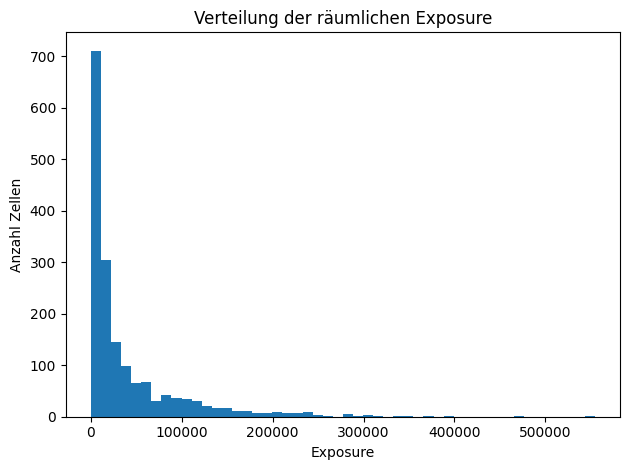

In [18]:
# Verteilung der Exposure (lineare Skala)
# plt.figure(figsize=(5,5))
plt.hist(active['exposure_total'], bins=50)
plt.title("Verteilung der räumlichen Exposure")
plt.xlabel("Exposure")
plt.ylabel("Anzahl Zellen")
plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_distribution.png"), dpi=300)
plt.show()

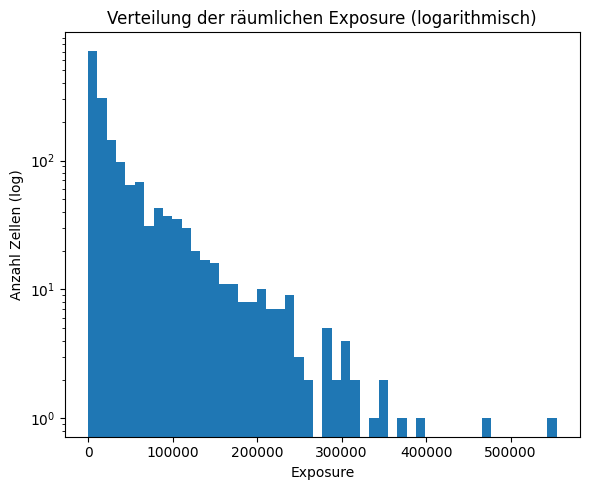

In [19]:
# Verteilung der Exposure (logarithmische Y-Skala)
plt.figure(figsize=(6,5))
plt.hist(active['exposure_total'], bins=50)
plt.yscale("log")  # wichtig bei stark schiefer Verteilung
plt.title("Verteilung der räumlichen Exposure (logarithmisch)")
plt.xlabel("Exposure")
plt.ylabel("Anzahl Zellen (log)")
plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_distribution_log.png"), dpi=300)
plt.show()

### 4.2 Statistische Kennzahlen der Exposure

Zur Einordnung der Verteilung werden zentrale Lage- und Streuungsmaße berechnet.

In [20]:
# Statistische Kennzahlen der Exposure
ex = active['exposure_total']

summary = pd.DataFrame({
    "metric": ["count", "min", "median", "mean", "90%", "95%", "99%", "max"],
    "value": [
        ex.count(),
        ex.min(),
        ex.median(),
        ex.mean(),
        ex.quantile(0.90),
        ex.quantile(0.95),
        ex.quantile(0.99),
        ex.max(),
    ]
})

print("Statistische Kennzahlen der räumlichen Exposure:")
summary

Statistische Kennzahlen der räumlichen Exposure:


,metric,value
0,count,1716.000000
1,min,1.000000
2,median,15383.500000
3,mean,40038.881702
4,90%,114119.000000
5,95%,165359.250000
6,99%,282202.750000
7,max,554391.000000


### 4.3 Gesamt-Exposure – räumliche Darstellung

Die räumliche Verteilung der gesamten Exposure wird auf Basis der WebMercator-Projektion dargestellt. Die logarithmierte Farbskala ermöglicht eine differenzierte Betrachtung stark variierender Nutzungsintensitäten.

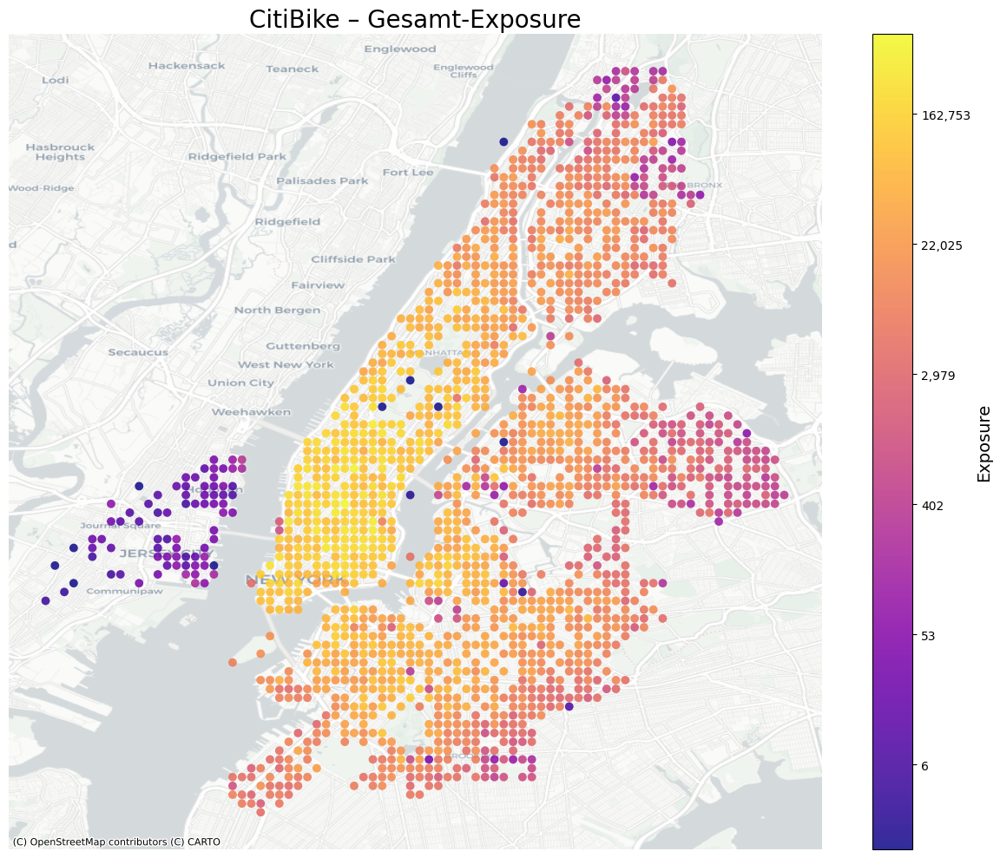

In [33]:
# WebMercator-Projektion
transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)

# Logarithmierte Exposure-Werte für Farbskala
log_vals = np.log1p(active['exposure_total'])

# Koordinaten transformieren
x_web, y_web = transformer.transform(active['lon_center'], active['lat_center'])

# Plot
fig, ax = plt.subplots(figsize=(12,10))

sc = ax.scatter(
    x_web, y_web,
    c=log_vals,
    cmap='plasma',
    s=50,
    alpha=0.85,
    edgecolor='none'
)

# Basemap laden
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

# Farbskala beschriften
cbar = fig.colorbar(sc, ax=ax)
log_ticks = [2,4,6,8,10,12]
log_ticks = [t for t in log_ticks if t <= log_vals.max()]
real_vals = [int(np.expm1(t)) for t in log_ticks]

cbar.set_ticks(log_ticks)
cbar.set_ticklabels([f"{v:,}" for v in real_vals])
cbar.set_label("Exposure", fontsize=14)

ax.set_title("CitiBike – Gesamt-Exposure", fontsize=20)
ax.set_axis_off()
plt.tight_layout()

plt.savefig(os.path.join(figures_path, "exposure_total_map.png"), dpi=300)
plt.show()

### 4.4 Räumliche Muster der E-Bike-Nutzung

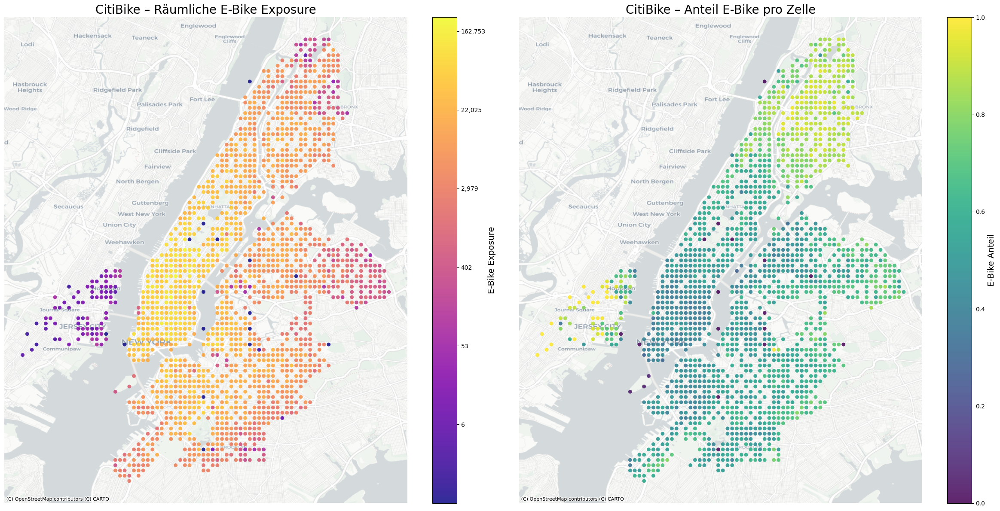

In [34]:
# Koordinaten transformieren
x_web, y_web = transformer.transform(active['lon_center'], active['lat_center'])

# Absolute Exposure logarithmieren
log_e = np.log1p(active['exposure_electric'])

fig, axes = plt.subplots(1, 2, figsize=(24,12))

# Absolute Nutzung
sc1 = axes[0].scatter(
    x_web, y_web,
    c=log_e,
    cmap='plasma',
    s=40,
    alpha=0.85,
    edgecolor='none'
)

ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

# Farbleiste mit echten Werten
ticks = [2,4,6,8,10,12]
ticks = [t for t in ticks if t <= log_e.max()]
real = [int(np.expm1(t)) for t in ticks]

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real])
cbar1.set_label("E-Bike Exposure", fontsize=14)

axes[0].set_title("CitiBike – Räumliche E-Bike Exposure", fontsize=20)
axes[0].set_axis_off()

# Relativer Anteil
ratio_e = active['exposure_electric'] / active['exposure_total']

sc2 = axes[1].scatter(
    x_web, y_web,
    c=ratio_e,
    cmap='viridis',
    s=40,
    alpha=0.85,
    edgecolor='none'
)

ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("E-Bike Anteil", fontsize=14)

axes[1].set_title("CitiBike – Anteil E-Bike pro Zelle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_ebike_absolute_ratio.png"), dpi=300)
plt.show()


### 4.5 Räumliche Muster der Classic-Bike-Nutzung

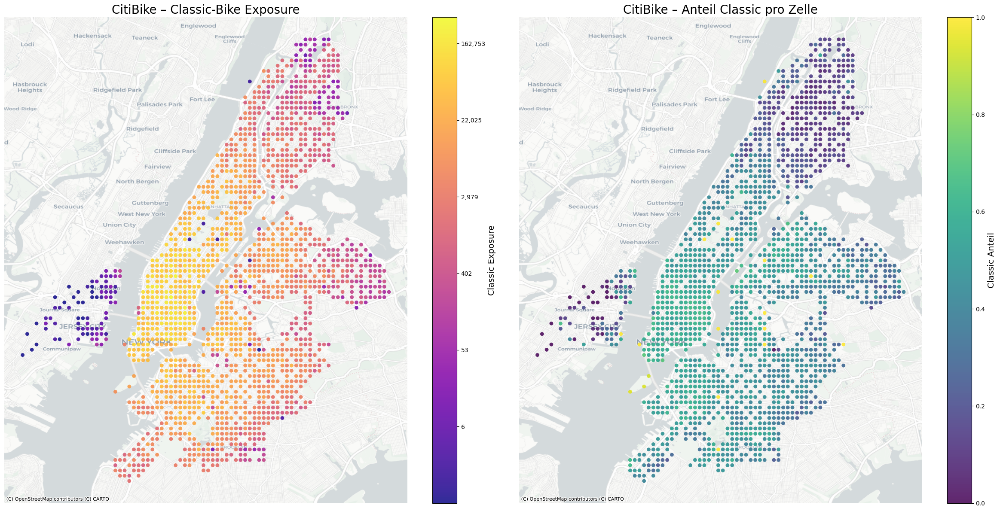

In [35]:
# Absolute Classic Exposure (log)
log_c = np.log1p(active['exposure_classic'])

fig, axes = plt.subplots(1, 2, figsize=(24,12))

# Absolute Nutzung
sc1 = axes[0].scatter(
    x_web, y_web,
    c=log_c,
    cmap='plasma',
    s=40,
    alpha=0.85,
    edgecolor='none'
)
ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

ticks = [2,4,6,8,10,12]
ticks = [t for t in ticks if t <= log_c.max()]
real = [int(np.expm1(t)) for t in ticks]

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real])
cbar1.set_label("Classic Exposure", fontsize=14)

axes[0].set_title("CitiBike – Classic-Bike Exposure", fontsize=20)
axes[0].set_axis_off()

# Relativer Anteil
ratio_c = active['exposure_classic'] / active['exposure_total']

sc2 = axes[1].scatter(
    x_web, y_web,
    c=ratio_c,
    cmap='viridis',
    s=40,
    alpha=0.85,
    edgecolor='none'
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("Classic Anteil", fontsize=14)

axes[1].set_title("CitiBike – Anteil Classic pro Zelle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_classic_absolute_ratio.png"), dpi=300)
plt.show()


### 4.6 Räumliche Muster der Member-Nutzung

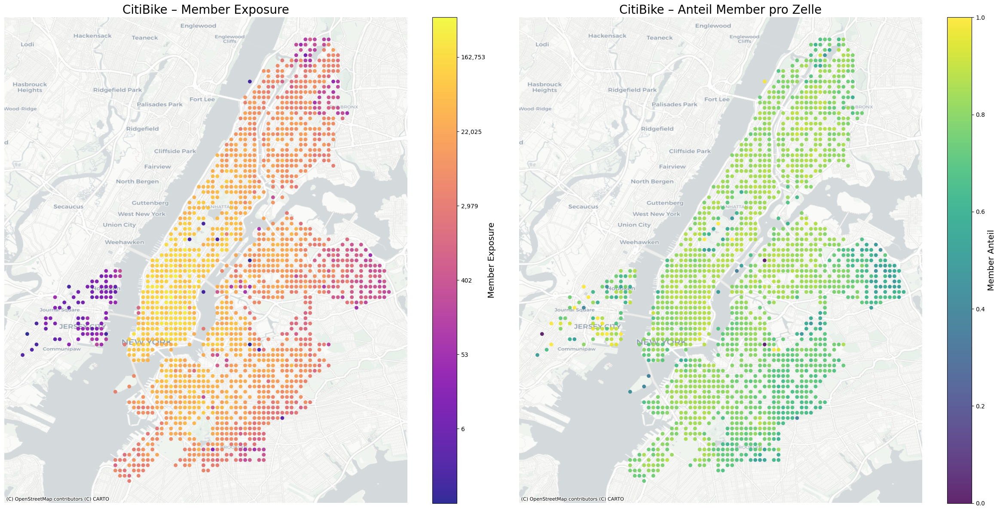

In [36]:
# Absolute Member Exposure
log_m = np.log1p(active['exposure_member'])

fig, axes = plt.subplots(1, 2, figsize=(24,12))

sc1 = axes[0].scatter(
    x_web, y_web,
    c=log_m,
    cmap='plasma',
    s=40,
    alpha=0.85,
    edgecolor='none'
)

ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

ticks = [2,4,6,8,10,12]
ticks = [t for t in ticks if t <= log_m.max()]
real = [int(np.expm1(t)) for t in ticks]

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real])
cbar1.set_label("Member Exposure", fontsize=14)

axes[0].set_title("CitiBike – Member Exposure", fontsize=20)
axes[0].set_axis_off()

# Relativer Anteil
ratio_m = active['exposure_member'] / active['exposure_total']

sc2 = axes[1].scatter(
    x_web, y_web,
    c=ratio_m,
    cmap='viridis',
    s=40,
    alpha=0.85,
    edgecolor='none'
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("Member Anteil", fontsize=14)

axes[1].set_title("CitiBike – Anteil Member pro Zelle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_member_absolute_ratio.png"), dpi=300)
plt.show()

### 4.7 Räumliche Muster der Casual-Nutzung

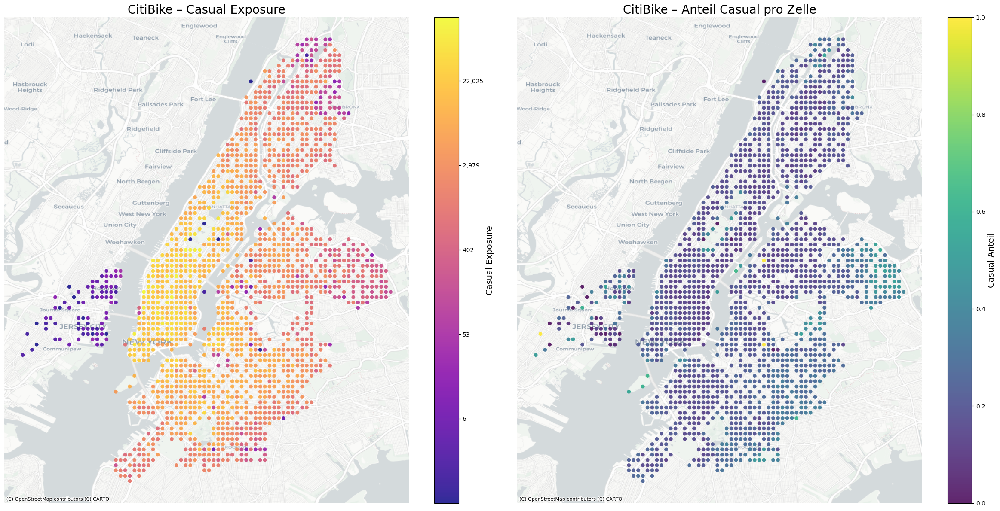

In [37]:
# Absolute Casual Exposure
log_cas = np.log1p(active['exposure_casual'])

fig, axes = plt.subplots(1, 2, figsize=(24,12))

sc1 = axes[0].scatter(
    x_web, y_web,
    c=log_cas,
    cmap='plasma',
    s=40,
    alpha=0.85,
    edgecolor='none'
)
ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

ticks = [2,4,6,8,10,12]
ticks = [t for t in ticks if t <= log_cas.max()]
real = [int(np.expm1(t)) for t in ticks]

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real])
cbar1.set_label("Casual Exposure", fontsize=14)

axes[0].set_title("CitiBike – Casual Exposure", fontsize=20)
axes[0].set_axis_off()

# Relativer Anteil
ratio_cas = active['exposure_casual'] / active['exposure_total']

sc2 = axes[1].scatter(
    x_web, y_web,
    c=ratio_cas,
    cmap='viridis',
    s=40,
    alpha=0.85,
    edgecolor='none'
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("Casual Anteil", fontsize=14)

axes[1].set_title("CitiBike – Anteil Casual pro Zelle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "exposure_casual_absolute_ratio.png"), dpi=300)
plt.show()

## 5. Räumliche Analyse der NYPD-Unfalldaten

Dieser Abschnitt beschreibt die räumliche Struktur der Verkehrsunfälle im CitiBike-Gebiet. 
Die Analyse erfolgt ausschließlich deskriptiv. 
Ziel ist die Identifikation räumlicher Muster, nicht die Ableitung von Ursachen oder Risiken. 
Die Ergebnisse dienen als erste Einschätzung, wo Nutzung und Unfallhäufigkeiten räumlich zusammenfallen oder voneinander abweichen.

### 5.1 Datenbasis und räumliche Aufbereitung

Für die Analyse werden ausschließlich Unfälle berücksichtigt, die einer gültigen Rasterzelle zugeordnet werden konnten. 
Für jeden Unfall wird bestimmt, ob Radfahrende beteiligt waren, welcher Fahrradtyp erfasst wurde und ob das Ereignis als schwer gilt. Anschließend werden alle Variablen auf Rasterzellenebene aggregiert. Dadurch entsteht ein räumlich harmonisierter Datensatz mit:

- Gesamtunfällen pro Zelle
- Unfällen mit Radfahrenden (Bike, E-Bike, unklare Fälle)
- Unfällen ohne Radfahrbeteiligung
- verletzten und getöteten Personen, getrennt nach Cyclist- und Non-Cyclist-Unfällen

Diese Struktur bildet die zentrale Grundlage für die späteren räumlichen Vergleiche zwischen Exposure und Unfällen.

In [38]:
# Unfälle mit gültiger Rasterzelle auswählen
df_acc = df_nypd[df_nypd["crash_cell_idx"].notna()].copy()
df_acc["crash_cell_idx"] = df_acc["crash_cell_idx"].astype(int)

# Relevante Grundvariablen behalten
# (Rest wird gleich dazu berechnet)
keep_cols = [
    "COLLISION_ID",
    "crash_datetime",
    "LATITUDE", "LONGITUDE",
    "lat_bin", "lon_bin", "crash_cell_idx",
    "NUMBER OF PERSONS INJURED",
    "NUMBER OF PERSONS KILLED",
    "NUMBER OF CYCLIST INJURED",
    "NUMBER OF CYCLIST KILLED",
] + [f"VEHICLE TYPE CODE {i}" for i in range(1, 6)]

df_acc = df_acc[keep_cols].copy()

# Beteiligung von Radfahrenden identifizieren
df_acc["cyclist_involved"] = (
    (df_acc["NUMBER OF CYCLIST INJURED"] > 0) |
    (df_acc["NUMBER OF CYCLIST KILLED"] > 0)
)

# Fahrzeugtypen (Bike vs. E-Bike) aus Textfeldern ableiten
vehicle_cols = [f"VEHICLE TYPE CODE {i}" for i in range(1, 6)]

bike_keywords = ["bike", "bicycle", "pedal bike", "cycle"]
ebike_keywords = ["e-bike", "ebike", "electric bike"]
motorcycle_keywords = ["motorcycle", "motor bike", "motorbike", "moped"]

def detect_vehicle_types(row):
    """Erkennt Fahrrad / E-Bike, schließt Motorräder aber zuverlässig aus."""
    types = [str(row[c]).lower() for c in vehicle_cols]

    # 1) Motorräder zuerst ausschließen
    if any(any(m in t for m in motorcycle_keywords) for t in types):
        return pd.Series({"bike_involved": False, "ebike_involved": False})
    
    # 2) E-Bike identifizieren (explizite Keywords)
    ebike = any(any(k in t for k in ebike_keywords) for t in types)

    # 3) Fahrrad erkennen (nach Ausschluss Motorrad)
    bike = any(any(k in t for k in bike_keywords) for t in types)

    return pd.Series({"bike_involved": bike, "ebike_involved": ebike})

df_acc[["bike_involved", "ebike_involved"]] = df_acc.apply(
    detect_vehicle_types, axis=1
)

# Fälle mit Radfahrbeteiligung, aber ohne erkannten Fahrradtyp markieren
df_acc["ambiguous"] = (
    df_acc["cyclist_involved"] &
    (~df_acc["bike_involved"]) &
    (~df_acc["ebike_involved"])
)

# Schwereinformationen ableiten
df_acc["persons_severe"] = (
    df_acc["NUMBER OF PERSONS INJURED"] +
    df_acc["NUMBER OF PERSONS KILLED"]
)

df_acc["cyclists_severe"] = (
    df_acc["NUMBER OF CYCLIST INJURED"] +
    df_acc["NUMBER OF CYCLIST KILLED"]
)

# Indikatoren für schwere Ereignisse setzen
df_acc["severe_event"] = df_acc["persons_severe"] > 0
df_acc["cyclist_severe_event"] = df_acc["cyclists_severe"] > 0

# Finale Variablen auswählen
cols_final = [
    "COLLISION_ID",
    "crash_datetime",
    "LATITUDE", "LONGITUDE",
    "lat_bin", "lon_bin", "crash_cell_idx",

    "cyclist_involved",
    "bike_involved",
    "ebike_involved",
    "ambiguous",

    "severe_event",
    "cyclist_severe_event",

    "NUMBER OF PERSONS INJURED",
    "NUMBER OF PERSONS KILLED",
    "persons_severe",

    "NUMBER OF CYCLIST INJURED",
    "NUMBER OF CYCLIST KILLED",
    "cyclists_severe",
]

df_nypd_spatial_granular = df_acc[cols_final].copy()

print("Unfälle im granularen Datensatz:", df_nypd_spatial_granular.shape[0])
df_nypd_spatial_granular.head()

Unfälle im granularen Datensatz: 61594


,COLLISION_ID,crash_datetime,LATITUDE,LONGITUDE,lat_bin,lon_bin,crash_cell_idx,cyclist_involved,bike_involved,ebike_involved,ambiguous,severe_event,cyclist_severe_event,NUMBER OF PERSONS INJURED,NUMBER OF PERSONS KILLED,persons_severe,NUMBER OF CYCLIST INJURED,NUMBER OF CYCLIST KILLED,cyclists_severe
0,4599014,2023-01-01 05:30:00,40.710514,-73.956140,40.710,-73.959,2175,False,False,False,False,False,False,0,0,0,0,0,0
1,4598137,2023-01-01 08:45:00,40.845870,-73.890730,40.845,-73.893,5887,False,False,False,False,False,False,0,0,0,0,0,0
2,4599015,2023-01-01 19:00:00,40.708237,-73.943370,40.707,-73.944,2098,False,False,False,False,True,False,1,0,1,0,0,0
3,4599499,2023-01-01 16:35:00,40.693660,-73.931540,40.692,-73.932,1692,False,False,False,False,False,False,0,0,0,0,0,0
4,4599239,2023-01-01 00:00:00,40.745068,-73.936356,40.743,-73.938,3084,False,False,False,False,False,False,0,0,0,0,0,0


#### 5.1.1 Personenfolgen und Aggregation auf Rasterzellenebene

Auf Basis des granularen Unfalldatensatzes werden verletzte und getötete Personen getrennt nach Cyclist- und Non-Cyclist-Unfällen berechnet. 
Anschließend werden alle Variablen auf Rasterzellenebene aggregiert und um Geometriedaten ergänzt. 
Dies bildet die räumliche Grundlage für die spätere Visualisierung der Unfallmuster.

In [39]:
# Personenfolgen für Cyclist- und Non-Cyclist-Unfälle bestimmen
df = df_nypd_spatial_granular.copy()

# Verletzte/Getötete aus Cyclist-Unfällen
df["injured_from_cyclist"] = np.where(
    df["cyclist_involved"],
    df["NUMBER OF PERSONS INJURED"] + df["NUMBER OF CYCLIST INJURED"],
    0
)

df["killed_from_cyclist"] = np.where(
    df["cyclist_involved"],
    df["NUMBER OF PERSONS KILLED"] + df["NUMBER OF CYCLIST KILLED"],
    0
)

# Verletzte/Getötete aus Unfällen ohne Radfahrbeteiligung
df["injured_from_non_cyclist"] = np.where(
    ~df["cyclist_involved"],
    df["NUMBER OF PERSONS INJURED"],
    0
)

df["killed_from_non_cyclist"] = np.where(
    ~df["cyclist_involved"],
    df["NUMBER OF PERSONS KILLED"],
    0
)

# Aggregation aller Variablen auf Rasterzellenebene
group = df.groupby("crash_cell_idx")

df_nypd_spatial_cell = pd.DataFrame({
    "cell_idx":           group.size().index,
    "crashes_total":      group.size().values,
    "crashes_cyclist":    group["cyclist_involved"].sum().values,
    "crashes_bike":       group["bike_involved"].sum().values,
    "crashes_ebike":      group["ebike_involved"].sum().values,
})

# Unklare Fahrradunfälle (Cyclist involviert, aber kein Bike/E-Bike erkannt)
df_nypd_spatial_cell["crashes_ambiguous"] = (
    df_nypd_spatial_cell["crashes_cyclist"]
    - df_nypd_spatial_cell["crashes_bike"]
    - df_nypd_spatial_cell["crashes_ebike"]
).clip(lower=0)

# Unfälle ohne Radfahrbeteiligung
df_nypd_spatial_cell["crashes_non_cyclist"] = (
    df_nypd_spatial_cell["crashes_total"] - df_nypd_spatial_cell["crashes_cyclist"]
)

# Aggregierte Personenfolgen pro Zelle
df_nypd_spatial_cell["injured_from_cyclist_crashes"] = group["injured_from_cyclist"].sum().values
df_nypd_spatial_cell["killed_from_cyclist_crashes"]  = group["killed_from_cyclist"].sum().values

df_nypd_spatial_cell["injured_from_non_cyclist_crashes"] = group["injured_from_non_cyclist"].sum().values
df_nypd_spatial_cell["killed_from_non_cyclist_crashes"]  = group["killed_from_non_cyclist"].sum().values

# Geometriedaten ergänzen
df_nypd_spatial_cell = df_nypd_spatial_cell.merge(
    df_cells[["cell_idx", "lat_bin", "lon_bin", "lat_center", "lon_center"]],
    on="cell_idx",
    how="left"
)

print("Rasterzellen im aggregierten Unfall-Datensatz:", df_nypd_spatial_cell.shape[0])
df_nypd_spatial_cell.head()

Rasterzellen im aggregierten Unfall-Datensatz: 3527


,cell_idx,crashes_total,crashes_cyclist,crashes_bike,crashes_ebike,crashes_ambiguous,crashes_non_cyclist,injured_from_cyclist_crashes,killed_from_cyclist_crashes,injured_from_non_cyclist_crashes,killed_from_non_cyclist_crashes,lat_bin,lon_bin,lat_center,lon_center
0,0,16,1,1,0,0,15,2,0,5,0,40.632,-74.088,40.6335,-74.0865
1,1,7,0,0,0,0,7,0,0,0,0,40.632,-74.085,40.6335,-74.0835
2,2,1,0,0,0,0,1,0,0,0,0,40.632,-74.082,40.6335,-74.0805
3,3,8,0,0,0,0,8,0,0,5,0,40.632,-74.079,40.6335,-74.0775
4,4,4,0,0,0,0,4,0,0,1,0,40.632,-74.076,40.6335,-74.0745


### 5.2 Räumliche Muster der Unfälle

Die räumliche Struktur der Unfälle wird durch mehrere Analyseformen dargestellt.
Zunächst erfolgt eine statistische Einordnung der Unfallverteilung über alle Rasterzellen.
Anschließend werden die Muster kartografisch visualisiert, getrennt nach Unfallhäufigkeit, Cyclist-Beteiligung, Unfallfolgen und E-Bike-Unfällen.
Absolute Werte werden logarithmiert dargestellt, um die starke Rechtssteilheit der Unfallzahlen abzubilden.
Relative Anteile werden linear gezeigt, um Belastungsschwerpunkte unabhängig vom allgemeinen Verkehrsaufkommen sichtbar zu machen.

#### 5.2.1 Verteilung der Unfallzahlen pro Rasterzelle

Zur Einordnung der räumlichen Unfallhäufigkeiten wird zunächst die Verteilung der Unfallzahlen pro Rasterzelle betrachtet.
Die Analyse umfasst ausschließlich Zellen mit mindestens einem registrierten Unfall.
Ergänzend werden Lage- und Streuungskennzahlen berechnet, um die Verteilung numerisch einzuordnen.

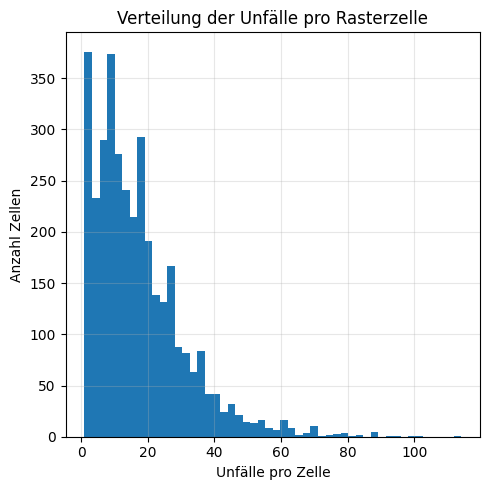

In [40]:
# Zellen mit mindestens einem Unfall auswählen
vals_total = df_nypd_spatial_cell.loc[
    df_nypd_spatial_cell["crashes_total"] > 0,
    "crashes_total"
]

# Histogramm der Unfallzahlen pro Zelle
plt.figure(figsize=(5,5))
plt.hist(vals_total, bins=50)
plt.title("Verteilung der Unfälle pro Rasterzelle")
plt.xlabel("Unfälle pro Zelle")
plt.ylabel("Anzahl Zellen")
plt.grid(alpha=0.3)
plt.tight_layout()

plt.savefig(os.path.join(figures_path, "crashes_distribution.png"), dpi=300)
plt.show()

In [41]:
# Zusammenfassende Kennzahlen berechnen
def make_summary(series):
    """Berechnet Lage- und Streuungskennzahlen für Werte > 0."""
    s = series[series > 0].astype(float)

    if len(s) == 0:
        return {
            "count": 0, "min": 0, "mean": 0, "median": 0, "std": 0,
            "p75": 0, "p90": 0, "p95": 0, "p99": 0, "max": 0
        }

    return {
        "count":  s.count(),
        "min":    s.min(),
        "mean":   s.mean(),
        "median": s.median(),
        "std":    s.std(),
        "p75":    s.quantile(0.75),
        "p90":    s.quantile(0.90),
        "p95":    s.quantile(0.95),
        "p99":    s.quantile(0.99),
        "max":    s.max()
    }

summary_dict = {}

# Alle relevanten Kennzahlen aus df_nypd_spatial_cell berechnen
metrics = [
    # Unfallanzahlen
    "crashes_total",
    "crashes_cyclist",
    "crashes_bike",
    "crashes_ebike",
    "crashes_ambiguous",
    "crashes_non_cyclist",

    # Personenfolgen Cyclist-Unfälle
    "injured_from_cyclist_crashes",
    "killed_from_cyclist_crashes",

    # Personenfolgen Non-Cyclist-Unfälle
    "injured_from_non_cyclist_crashes",
    "killed_from_non_cyclist_crashes",
]

for col in metrics:
    summary_dict[col] = make_summary(df_nypd_spatial_cell[col])

summary_df = pd.DataFrame(summary_dict).T

print("Zusammenfassende Kennzahlen pro Rasterzelle:")
summary_df

Zusammenfassende Kennzahlen pro Rasterzelle:


,count,min,mean,median,std,p75,p90,p95,p99,max
crashes_total,3527.0,1.0,17.463567,14.0,13.892475,24.0,35.0,43.0,67.00,114.0
crashes_cyclist,1763.0,1.0,2.265457,2.0,1.807376,3.0,5.0,6.0,9.00,13.0
crashes_bike,2132.0,1.0,2.888368,2.0,2.459186,4.0,6.0,8.0,13.00,20.0
crashes_ebike,1263.0,1.0,1.565321,1.0,0.963831,2.0,3.0,3.0,6.00,7.0
crashes_ambiguous,15.0,1.0,1.000000,1.0,0.000000,1.0,1.0,1.0,1.00,1.0
crashes_non_cyclist,3522.0,1.0,16.354344,13.0,13.056948,22.0,32.0,40.0,62.00,111.0
injured_from_cyclist_crashes,1758.0,2.0,4.684300,4.0,3.883607,6.0,10.0,12.0,20.00,43.0
killed_from_cyclist_crashes,22.0,2.0,2.000000,2.0,0.000000,2.0,2.0,2.0,2.00,2.0
injured_from_non_cyclist_crashes,3233.0,1.0,9.137024,7.0,8.419212,12.0,19.0,25.0,40.68,76.0
killed_from_non_cyclist_crashes,134.0,1.0,1.029851,1.0,0.170814,1.0,1.0,1.0,2.00,2.0


### 5.2.2 Gesamtunfälle und Anteil Cyclist-Unfälle

Es wird zunächst dargestellt, in welchen Bereichen des Stadtgebiets die allgemeine Unfallhäufigkeit konzentriert ist. 
Anschließend wird der Anteil von Cyclist-Unfällen pro Rasterzelle gezeigt. 
Dadurch lassen sich Zellen identifizieren, in denen Radfahrende überdurchschnittlich häufig betroffen sind – unabhängig vom allgemeinen Unfallniveau.

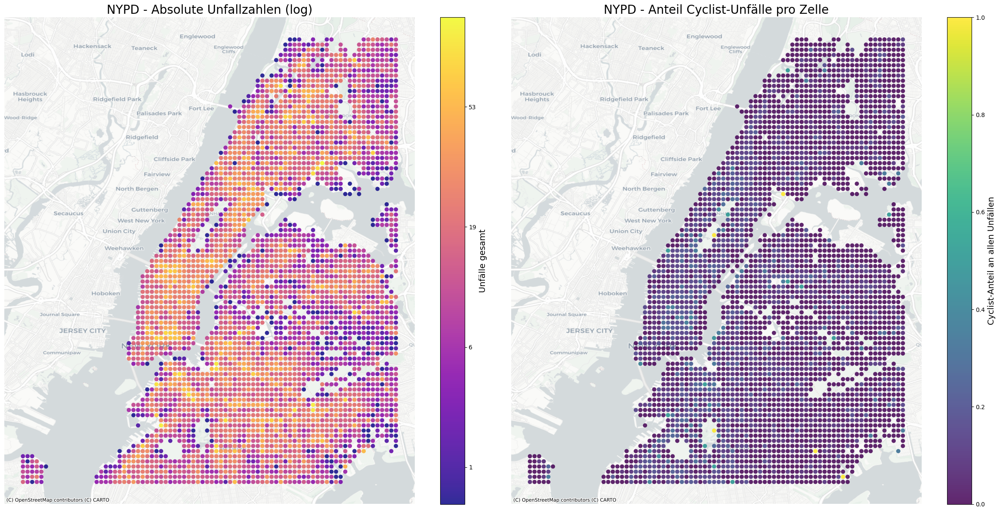

In [43]:
# Zellen mit mindestens einem Unfall auswählen
active = df_nypd_spatial_cell[
    df_nypd_spatial_cell["crashes_total"] > 0
].copy()

# WebMercator
x, y = transformer.transform(active["lon_center"], active["lat_center"])

# Plotpaar erzeugen
fig, axes = plt.subplots(1, 2, figsize=(24, 12))

# Absolute Unfallzahlen (logarithmisch)
log_vals = np.log1p(active["crashes_total"])

tick_candidates = [1,2,3,4,5,6]
ticks = [t for t in tick_candidates if t <= log_vals.max()]
real_vals = [int(np.expm1(t)) for t in ticks]

sc1 = axes[0].scatter(
    x, y,
    c=log_vals,
    cmap="plasma",
    s=50, 
    alpha=0.85, 
    edgecolor="none"
)
ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real_vals])
cbar1.set_label("Unfälle gesamt", fontsize=14)

axes[0].set_title("NYPD - Absolute Unfallzahlen (log)", fontsize=20)
axes[0].set_axis_off()

# Anteil Cyclist-Unfälle
active["cyclist_share"] = (
    active["crashes_cyclist"] /
    active["crashes_total"].replace(0, np.nan)
).fillna(0)

sc2 = axes[1].scatter(
    x, y,
    c=active["cyclist_share"],
    cmap="viridis",
    s=50, 
    alpha=0.85, 
    edgecolor="none"
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("Cyclist-Anteil an allen Unfällen", fontsize=14)

axes[1].set_title("NYPD - Anteil Cyclist-Unfälle pro Zelle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "crashes_total_and_cyclist_share.png"), dpi=300)
plt.show()

### 5.2.3 Räumliche Schwere der Unfälle

Die Schwere der Unfälle wird getrennt für Ereignisse mit und ohne Radfahrbeteiligung dargestellt. 
Grundlage ist die Anzahl verletzter oder getöteter Personen pro Unfallereignis. 
Die logarithmische Darstellung ermöglicht eine differenzierte Betrachtung, da die Schwere der Ereignisse stark rechtsschief verteilt ist. 
Beide Karten nutzen eine gemeinsame Farbskala, um Unterschiede zwischen den Gruppen unmittelbar vergleichbar zu machen.

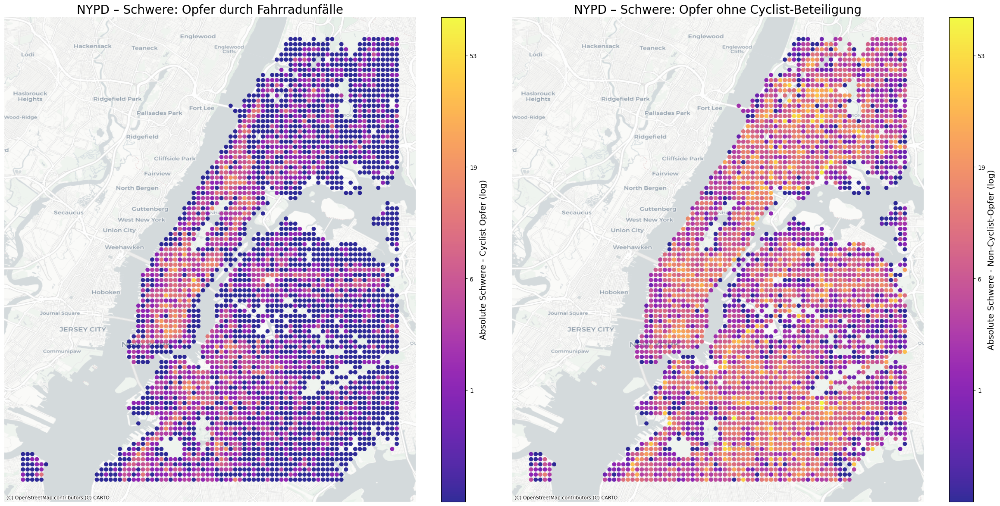

In [44]:
# Zellen mit mindestens einem Unfall auswählen
active = df_nypd_spatial_cell[
    (df_nypd_spatial_cell["crashes_total"] > 0)
].copy()

# Absolute Schwere berechnen
active['severity_cyclist'] = (
    active['injured_from_cyclist_crashes'] +
    active['killed_from_cyclist_crashes']
)

active['severity_non_cyclist'] = (
    active['injured_from_non_cyclist_crashes'] +
    active['killed_from_non_cyclist_crashes']
)

# Logarithmierte Werte erzeugen
active['log_severity_cyclist'] = np.log1p(active['severity_cyclist'])
active['log_severity_non_cyclist'] = np.log1p(active['severity_non_cyclist'])

# WebMercator
x, y = transformer.transform(active["lon_center"], active["lat_center"])

# Gemeinsame Farbskala bestimmen
max_log_val = max(active['log_severity_cyclist'].max(), active['log_severity_non_cyclist'].max())

tick_candidates = [1, 2, 3, 4, 5, 6]
ticks = [t for t in tick_candidates if t <= max_log_val]
real_vals = [int(np.expm1(t)) for t in ticks]

# Plotpaar erzeugen
fig, axes = plt.subplots(1, 2, figsize=(24, 12))

# Schwere in Cyclist-Unfällen
sc1 = axes[0].scatter(
    x, y,
    c=active["log_severity_cyclist"],
    cmap="plasma",
    s=50, 
    alpha=0.85, 
    edgecolor="none",
    vmin=0, 
    vmax=max_log_val # Wichtig: Gleiche Skala in beiden Abbildungen
)
ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real_vals])
cbar1.set_label("Absolute Schwere - Cyclist Opfer (log)", fontsize=14)

axes[0].set_title("NYPD – Schwere: Opfer durch Fahrradunfälle", fontsize=20)
axes[0].set_axis_off()

# Schwere in Non-Cyclist-Unfällen
sc2 = axes[1].scatter(
    x, y,
    c=active["log_severity_non_cyclist"],
    cmap="plasma",
    s=50, 
    alpha=0.85, 
    edgecolor="none",
    vmin=0, 
    vmax=max_log_val # Wichtig: Gleiche Skala in beiden Abbildungen
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_ticks(ticks)
cbar2.set_ticklabels([f"{v:,}" for v in real_vals])
cbar2.set_label("Absolute Schwere - Non-Cyclist-Opfer (log)", fontsize=14)

axes[1].set_title("NYPD – Schwere: Opfer ohne Cyclist-Beteiligung", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "severity_cyclist_non_cyclist.png"), dpi=300)
plt.show()

### 5.2.4 E-Bike-Unfälle und E-Bike-Anteil

Dieses Kartenpaar zeigt die räumliche Verteilung der E-Bike-Unfälle. 
Zunächst werden die absoluten E-Bike-Crashzahlen logarithmisch dargestellt, da diese Ereignisse selten auftreten und stark rechtsschief verteilt sind. 
Anschließend wird der relative Anteil der E-Bike-Unfälle an allen identifizierten Fahrradunfällen pro Rasterzelle visualisiert. 
Dadurch wird sichtbar, in welchen Bereichen E-Bikes eine überdurchschnittliche Rolle im Unfallgeschehen spielen.

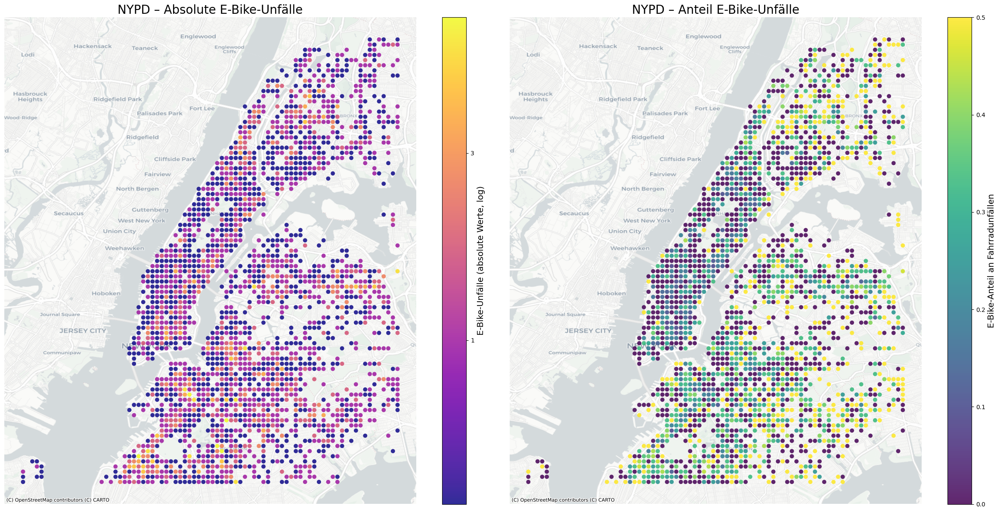

In [45]:
# Zellen auswählen, in denen mindestens ein Fahrrad- oder E-Bike-Unfall registriert wurde
active = df_nypd_spatial_cell[
    (df_nypd_spatial_cell["crashes_bike"] > 0) |
    (df_nypd_spatial_cell["crashes_ebike"] > 0)
].copy()

# WebMercator Transformation
x, y = transformer.transform(active["lon_center"], active["lat_center"])

# Absolute E-Bike-Crashes logarithmieren
log_vals_e = np.log1p(active["crashes_ebike"])

tick_candidates = [0.7, 1.5, 2.5, 3.5]
ticks = [t for t in tick_candidates if t <= log_vals_e.max()]
real_vals = [int(np.expm1(t)) for t in ticks]

# Plotpaar erzeugen
fig, axes = plt.subplots(1, 2, figsize=(24, 12))

# Absolute E-Bike-Unfälle (log)
sc1 = axes[0].scatter(
    x, y,
    c=log_vals_e,
    cmap="plasma",
    s=50, 
    alpha=0.85, 
    edgecolor="none"
)
ctx.add_basemap(axes[0], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar1 = fig.colorbar(sc1, ax=axes[0])
cbar1.set_ticks(ticks)
cbar1.set_ticklabels([f"{v:,}" for v in real_vals])
cbar1.set_label("E-Bike-Unfälle (absolute Werte, log)", fontsize=14)

axes[0].set_title("NYPD – Absolute E-Bike-Unfälle", fontsize=20)
axes[0].set_axis_off()

# Anteil E-Bike-Unfälle pro Zelle berechnen
active["ebike_share"] = (
    active["crashes_ebike"] /
    (active["crashes_bike"] + active["crashes_ebike"]).replace(0, np.nan)
).fillna(0) # Null setzen, wenn Zelle 0 E-Bike und 0 Bike hat (sollte durch Filter oben abgedeckt sein)

# Anteil E-Bike-Unfälle
sc2 = axes[1].scatter(
    x, y,
    c=active["ebike_share"],
    cmap="viridis",
    s=50, 
    alpha=0.85, 
    edgecolor="none"
)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron, crs="EPSG:3857")

cbar2 = fig.colorbar(sc2, ax=axes[1])
cbar2.set_label("E-Bike-Anteil an Fahrradunfällen", fontsize=14)

axes[1].set_title("NYPD – Anteil E-Bike-Unfälle", fontsize=20)
axes[1].set_axis_off()

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "ebike_crashes_and_share.png"), dpi=300)
plt.show()

## 5.3 Zusammenhang zwischen Nutzung und Unfällen

Um die Beziehung zwischen CitiBike-Nutzung und Unfallhäufigkeiten strukturiert zu untersuchen, werden die Rasterzellen nach Exposure in quantilbasierte Gruppen (Deciles) eingeteilt. 
Die Betrachtung der mittleren Unfallzahlen sowie der Unfallraten innerhalb dieser Gruppen glättet das starke Rauschen einzelner Zellen und ermöglicht eine robuste Einschätzung, ob höhere Nutzung systematisch mit 
mehr Unfällen oder höheren Unfallraten einhergeht.

Die Analyse liefert somit eine erste, stabilere Annäherung an mögliche Zusammenhänge zwischen Nutzung und Unfallhäufigkeiten und bildet die Grundlage für die spätere Risikoquantifizierung.

### 5.3.1 Spatial Master erstellen

In [47]:
# Basisdatensatz mit allen Rasterzellen
df_master = df_cells[[
    "cell_idx", "lat_bin", "lon_bin", "lat_center", "lon_center"
]].copy()

# Exposure-Daten hinzufügen
df_master = df_master.merge(
    df_exposure_cells[[
        "cell_idx",
        "exposure_total",
        "exposure_member",
        "exposure_casual",
        "exposure_classic",
        "exposure_electric"
    ]],
    on="cell_idx",
    how="left"
)

# Unfallaggregationen hinzufügen
df_master = df_master.merge(
    df_nypd_spatial_cell[[
        "cell_idx",
        "crashes_total",
        "crashes_cyclist",
        "crashes_bike",
        "crashes_ebike",
        "crashes_ambiguous",
        "crashes_non_cyclist",
        "injured_from_cyclist_crashes",
        "killed_from_cyclist_crashes",
        "injured_from_non_cyclist_crashes",
        "killed_from_non_cyclist_crashes"
    ]],
    on="cell_idx",
    how="left"
)

# Fehlende Werte auffüllen
fill_cols = [
    "exposure_total", "exposure_member", "exposure_casual",
    "exposure_classic", "exposure_electric",
    "crashes_total", "crashes_cyclist", "crashes_bike",
    "crashes_ebike", "crashes_ambiguous", "crashes_non_cyclist",
    "injured_from_cyclist_crashes", "killed_from_cyclist_crashes",
    "injured_from_non_cyclist_crashes", "killed_from_non_cyclist_crashes"
]

df_master[fill_cols] = df_master[fill_cols].fillna(0).astype(int)
df_master

,cell_idx,lat_bin,lon_bin,lat_center,lon_center,exposure_total,exposure_member,exposure_casual,exposure_classic,exposure_electric,crashes_total,crashes_cyclist,crashes_bike,crashes_ebike,crashes_ambiguous,crashes_non_cyclist,injured_from_cyclist_crashes,killed_from_cyclist_crashes,injured_from_non_cyclist_crashes,killed_from_non_cyclist_crashes
0,0,40.632,-74.088,40.6335,-74.0865,0,0,0,0,0,16,1,1,0,0,15,2,0,5,0
1,1,40.632,-74.085,40.6335,-74.0835,0,0,0,0,0,7,0,0,0,0,7,0,0,0,0
2,2,40.632,-74.082,40.6335,-74.0805,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0
3,3,40.632,-74.079,40.6335,-74.0775,0,0,0,0,0,8,0,0,0,0,8,0,0,5,0
4,4,40.632,-74.076,40.6335,-74.0745,0,0,0,0,0,4,0,0,0,0,4,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7129,7129,40.890,-73.857,40.8915,-73.8555,0,0,0,0,0,16,0,1,1,0,16,0,0,8,0
7130,7130,40.890,-73.854,40.8915,-73.8525,0,0,0,0,0,14,1,1,0,0,13,2,0,10,0
7131,7131,40.890,-73.851,40.8915,-73.8495,0,0,0,0,0,11,0,0,0,0,11,0,0,8,0
7132,7132,40.890,-73.848,40.8915,-73.8465,0,0,0,0,0,3,0,0,0,0,3,0,0,2,0


### 5.3.2 Exposure-Decile vs. mittlere Cyclist-Unfälle

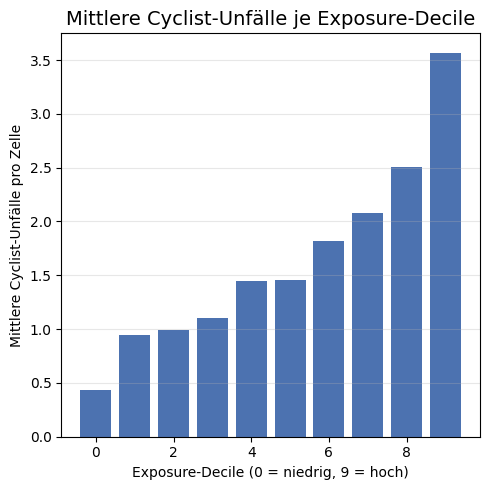

In [48]:
# Zellen mit positiver Exposure auswählen
active = df_master[df_master["exposure_total"] > 0].copy()

# Exposure in 10 Quantilgruppen einteilen
active["exposure_decile"] = pd.qcut(
    active["exposure_total"],
    q=10,
    labels=False
)

# Mittlere Cyclist-Unfälle je Decile berechnen
decile_mean_cyclist = (
    active
    .groupby("exposure_decile", observed=True)["crashes_cyclist"]
    .mean()
)

# Plot erzeugen
fig, ax = plt.subplots(figsize=(5, 5))
ax.bar(decile_mean_cyclist.index, decile_mean_cyclist.values, color="#4C72B0")

ax.set_title("Mittlere Cyclist-Unfälle je Exposure-Decile", fontsize=14)
ax.set_xlabel("Exposure-Decile (0 = niedrig, 9 = hoch)")
ax.set_ylabel("Mittlere Cyclist-Unfälle pro Zelle")
ax.grid(alpha=0.3, axis="y")

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "cyclist_crashes_by_exposure_decile.png"), dpi=300)
plt.show()


### 5.3.3 Exposure-Decile vs. mediane Crashrate

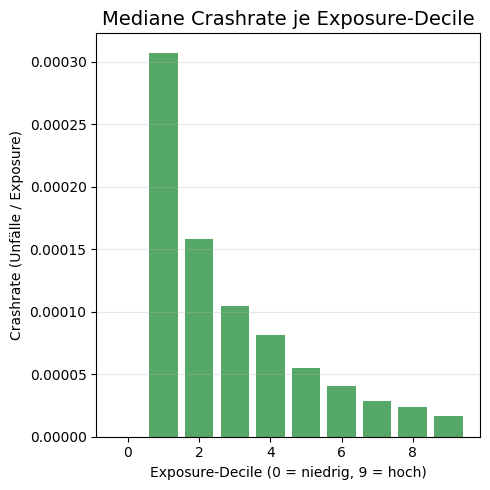

In [49]:
# Crashrate berechnen
active["crash_rate"] = active["crashes_cyclist"] / active["exposure_total"]

# Exposure-Deciles erneut bestimmen
active["exposure_decile"] = pd.qcut(
    active["exposure_total"],
    q=10,
    labels=False
)

# Mediane Crashrate pro Decile berechnen
decile_rate = (
    active
    .groupby("exposure_decile", observed=True)["crash_rate"]
    .median()
)

# Plot erzeugen
fig, ax = plt.subplots(figsize=(5, 5))
ax.bar(decile_rate.index, decile_rate.values, color="#55A868")

ax.set_title("Mediane Crashrate je Exposure-Decile", fontsize=14)
ax.set_xlabel("Exposure-Decile (0 = niedrig, 9 = hoch)")
ax.set_ylabel("Crashrate (Unfälle / Exposure)")
ax.grid(alpha=0.3, axis="y")

plt.tight_layout()
plt.savefig(os.path.join(figures_path, "crash_rate_by_exposure_decile.png"), dpi=300)
plt.show()

### 5.3.4 Export der räumlichen Datensätze

In [50]:
# Datensätze in der Projektstruktur speichern
df_master.to_parquet(os.path.join(DATA_SPATIAL, "spatial_master.parquet"), index=False)
df_nypd_spatial_granular.to_parquet(os.path.join(DATA_SPATIAL, "nypd_spatial_granular.parquet"), index=False)
df_cb.to_parquet(os.path.join(DATA_SPATIAL, "citibike_spatial_granular.parquet"), index=False)

print("Räumliche Datensätze gespeichert.")

Räumliche Datensätze gespeichert.
